# Analyzing TotalVI 10/30/2023 - 11/03/2023

This contains the first look at the totalvi with running the models with different data
In this notebook we discovered problems with the some naming convesntions which
required some reruns

In [1]:
import os
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)

import scanpy as sc
import anndata
import torch
import scarches as sca
import matplotlib.pyplot as plt
import numpy as np
import scvi as scv
import pandas as pd
from scvi.model import TOTALVI
from sklearn.ensemble import RandomForestClassifier



sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(dpi=200)
sc.set_figure_params(figsize=(4, 4))
torch.set_printoptions(precision=3, sci_mode=False, edgeitems=7)

 captum (see https://github.com/pytorch/captum).


In [15]:
import umap

# 'offline'/Default totalV - train model on whole data

Using a combination of these tutorials:
https://docs.scvi-tools.org/en/1.0.2/tutorials/notebooks/totalVI_reference_mapping.html
https://yoseflab.github.io/scvi-tools-reproducibility/scarches_totalvi_seurat_data/#totalvi-scarches


In [2]:
adata = sc.read('/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/data/fig4_data/adata/fig4_Protein_folzconversion.h5ad')
adata.layers["counts"] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata

In [3]:
adata.layers["counts"]

array([[0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       ...,
       [0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1., 0., 0., ..., 0., 1., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., ..., 0., 0., 0., 0., 0., 0., 0.]],
      d

In [4]:
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=4000,
    flavor="seurat_v3",
    batch_key="orig.ident",
    subset=True,
    layer="counts",
)

In [5]:
adata

AnnData object with n_obs × n_vars = 20046 × 4000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'species', 'nCount_ADT', 'nFeature_ADT', 'nCount_HTO', 'nFeature_HTO', 'percent.mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_species', 'Cell_Types', 'S.Score', 'G2M.Score', 'Phase', 'RNA_snn_res.0.2', 'seurat_clusters', 'unfilt_clusters', 'RNA.weight', 'ADT_denoised_iso_quant.weight'
    var: 'mouse', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'hvg'
    obsm: 'protein_expression'
    layers: 'counts'

In [6]:
TOTALVI.setup_anndata(
    adata,
    layer="counts",
    batch_key="orig.ident",
    protein_expression_obsm_key="protein_expression",
)

INFO     Using column names from columns of adata.obsm['protein_expression']                                       
INFO     Found batches with missing protein expression                                                             


In [21]:
'''
# # training code here
arches_params = dict(
    use_layer_norm="both",
    use_batch_norm="none",
    n_layers_decoder=2,
    n_layers_encoder=2,
)

vae = TOTALVI(adata, **arches_params)
vae.train(max_epochs=250)
vae.save("/storage1/fs1/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/conversion/TOTALVI/offline_default_model", overwrite=True)
'''

'\n# # training code here\narches_params = dict(\n    use_layer_norm="both",\n    use_batch_norm="none",\n    n_layers_decoder=2,\n    n_layers_encoder=2,\n)\n\nvae = TOTALVI(adata, **arches_params)\nvae.train(max_epochs=250)\nvae.save("/storage1/fs1/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/conversion/TOTALVI/offline_default_model", overwrite=True)\n'

In [7]:
vae_ref = TOTALVI.load("/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/models/full_model/10-26_run/offline_default_model", adata=adata)


INFO     File                                                                                                      
         /Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/mo
         dels/full_model/10-26_run/offline_default_model/model.pt already downloaded                               
INFO     Found batches with missing protein expression                                                             
INFO     Computing empirical prior initialization for protein background.                                          


In [8]:
import umap

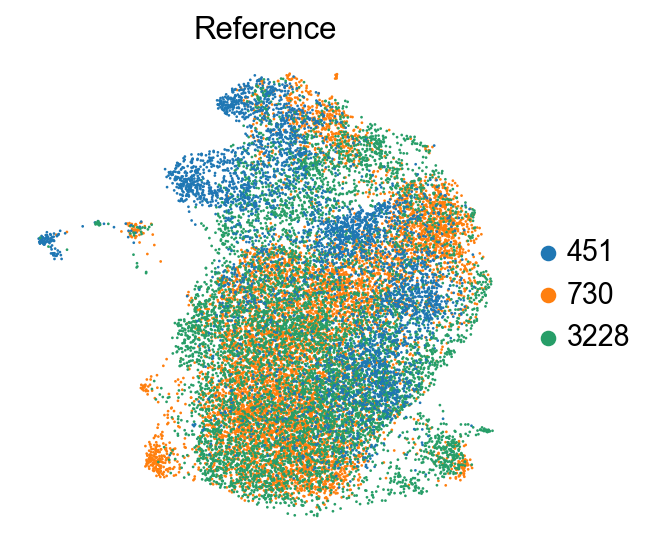

In [9]:
adata.obsm["X_totalVI"] = vae_ref.get_latent_representation()
sc.pp.neighbors(adata, use_rep="X_totalVI")
sc.tl.umap(adata, min_dist=0.4)
adata.obs["orig.ident"] = adata.obs["orig.ident"].astype("category")


sc.pl.umap(
    adata,
    color=["orig.ident"],
    frameon=False,
    ncols=1,
    title="Reference",
)


# 'online'/scArches totalV - train model on subset of data

In [10]:
def processing_online_model(vae_q, vae_ref, adata_ref, adata_query):

    plt.plot(vae_q.history["elbo_train"].iloc[10:], label="train")
    plt.plot(vae_q.history["elbo_validation"].iloc[10:], label="validation")
    plt.title("Negative ELBO over training epochs")
    plt.legend()

    adata_ref.obsm["X_totalvi_scarches"] = vae_ref.get_latent_representation()
    adata_query.obsm["X_totalvi_scarches"] = vae_q.get_latent_representation()

    # predict cell types of query
    y_train = adata_ref.obs["celltype.l2"].astype("category").cat.codes.to_numpy()
    X_train = adata_ref.obsm["X_totalvi_scarches"]

    classifier = "random_forest"
    if classifier == "random_forest":
        clf = RandomForestClassifier(
                random_state=1, 
                class_weight = "balanced_subsample",
                verbose=1,
                n_jobs=-1,
            )
    else:
        clf = MLPClassifier(
                hidden_layer_sizes=(128, 64, 32,), 
                random_state=1, 
                max_iter=300, 
                verbose=True, 
                early_stopping=True, 
                learning_rate_init=1e-3
            )
        
    clf.fit(X_train, y_train)
    # vae.latent_space_classifer_ = clf

    # Not sure what exactly this does from yosef
    predictions = clf.predict(adata_query.obsm["X_totalvi_scarches"])
    categories = adata_ref.obs["seurat_clusters"].astype("category").cat.categories
    cat_preds = [categories[i] for i in predictions]
    adata_query.obs["predicted_l2_scarches"] = cat_preds

    adata_query.obs["predicted_l2_scarches"] = adata_query.obs["predicted_l2_scarches"].replace({
        0: "CD56dim",
        1: "ML1",
        2: "ML2",
        3: "CD56bright",
        4: "CD56dim",
        5: "NKG2Cpos",
        6: "Proliferating1",
        7: "CD56dim",
        8: "Proliferating2",
        9: "nonNK"
    })

    adata_query.obs["seurat_clusters"] = adata_query.obs["seurat_clusters"].replace({
        0: "CD56dim",
        1: "ML1",
        2: "ML2",
        3: "CD56bright",
        4: "CD56dim",
        5: "NKG2Cpos",
        6: "Proliferating1",
        7: "CD56dim",
        8: "Proliferating2",
        9: "nonNK"
    })

    adata_ref.obs["seurat_clusters"] = adata_ref.obs["seurat_clusters"].replace({
        0: "CD56dim",
        1: "ML1",
        2: "ML2",
        3: "CD56bright",
        4: "CD56dim",
        5: "NKG2Cpos",
        6: "Proliferating1",
        7: "CD56dim",
        8: "Proliferating2",
        9: "nonNK"
    })

    print("Acc: {}".format(np.mean(adata_query.obs["seurat_clusters"] == adata_query.obs["predicted_l2_scarches"])))



    adata_query.obs["celltype.l2"] = adata_query.obs["predicted_l2_scarches"]

    adata_ref.obs["dataset_name"] = "Reference"
    adata_query.obs["dataset_name"] = "Query"

    adata_full_new = anndata.concat([adata_ref, adata_query])

    adata_full_new.uns["_scvi_uuid"] = adata_query.uns["_scvi_uuid"] #  adata_full_new.uns["_scvi"] = query.uns["_scvi"].copy()
    adata_full_new.obsm["X_totalvi_scarches"] = vae_q.get_latent_representation(adata_full_new)

    print("Computing full umap")
    sc.pp.neighbors(adata_full_new, use_rep="X_totalvi_scarches", metric="cosine")
    sc.tl.umap(adata_full_new, min_dist=0.3)

    return vae_ref, vae_q, adata_full_new



In [11]:
adata_all = sc.read('/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/data/fig4_data/adata/fig4_Protein_folzconversion.h5ad')
adata = adata_all.raw.to_adata()

adata.obs["celltype.l2"] = adata.obs["seurat_clusters"].replace({
    0: "CD56dim",
    1: "ML1",
    2: "ML2",
    3: "CD56bright",
    4: "CD56dim",
    5: "NKG2Cpos",
    6: "Proliferating1",
    7: "CD56dim",
    8: "Proliferating2",
    9: "nonNK"
})

# split into three data sets and assign a batch Key to each one
adata_3228 = adata[adata.obs['orig.ident'].isin([3228])].copy()
adata_3228.obs["batch"] = "3228"
adata_730 = adata[adata.obs['orig.ident'].isin([730])].copy()
adata_730.obs["batch"] = "730"
adata_451 = adata[adata.obs['orig.ident'].isin([451])].copy()
adata_451.obs["batch"] = "451"

In [12]:
adata_3228.obsm["protein_expression"].columns

Index(['CD38ADT', 'CD314ADT', 'HLA-DRADT', 'CD62LADT', 'CD45ROADT', 'CD337ADT',
       'CD56ADT', 'CD335ADT', 'CD57ADT', 'CD45RAADT', 'CD11bADT', 'CD16ADT',
       'CD25ADT', 'CD107aADT', 'CD117ADT', 'CD336ADT', 'NKG2AADT', 'IgG1ADT',
       'IgG2aADT', 'IgG2bADT', 'KIR2DL1-S1-S3-S5ADT', 'KIR2DL2-3ADT',
       'KIR3DL1ADT', 'KIR2DL5ADT', 'CD94ADT', 'NKG2CADT', 'PD-1ADT', 'CD8ADT'],
      dtype='object')

In [13]:
adata_451.obsm["protein_expression"].columns

Index(['CD38ADT', 'CD314ADT', 'HLA-DRADT', 'CD62LADT', 'CD45ROADT', 'CD337ADT',
       'CD56ADT', 'CD335ADT', 'CD57ADT', 'CD45RAADT', 'CD11bADT', 'CD16ADT',
       'CD25ADT', 'CD107aADT', 'CD117ADT', 'CD336ADT', 'NKG2AADT', 'IgG1ADT',
       'IgG2aADT', 'IgG2bADT', 'KIR2DL1-S1-S3-S5ADT', 'KIR2DL2-3ADT',
       'KIR3DL1ADT', 'KIR2DL5ADT', 'CD94ADT', 'NKG2CADT', 'PD-1ADT', 'CD8ADT'],
      dtype='object')

In [14]:
adata_730.obsm["protein_expression"].columns

# remove these features IgG2aADT, IgG2bADT, IgG1ADT, PD-1ADT, CD8ADT

Index(['CD38ADT', 'CD314ADT', 'HLA-DRADT', 'CD62LADT', 'CD45ROADT', 'CD337ADT',
       'CD56ADT', 'CD335ADT', 'CD57ADT', 'CD45RAADT', 'CD11bADT', 'CD16ADT',
       'CD25ADT', 'CD107aADT', 'CD117ADT', 'CD336ADT', 'NKG2AADT', 'IgG1ADT',
       'IgG2aADT', 'IgG2bADT', 'KIR2DL1-S1-S3-S5ADT', 'KIR2DL2-3ADT',
       'KIR3DL1ADT', 'KIR2DL5ADT', 'CD94ADT', 'NKG2CADT', 'PD-1ADT', 'CD8ADT'],
      dtype='object')

In [15]:
adata

AnnData object with n_obs × n_vars = 20046 × 16289
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'species', 'nCount_ADT', 'nFeature_ADT', 'nCount_HTO', 'nFeature_HTO', 'percent.mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_species', 'Cell_Types', 'S.Score', 'G2M.Score', 'Phase', 'RNA_snn_res.0.2', 'seurat_clusters', 'unfilt_clusters', 'RNA.weight', 'ADT_denoised_iso_quant.weight', 'celltype.l2'
    var: 'mouse', 'n_cells'
    obsm: 'protein_expression'

### Reference 3228, 730. Query 451 --- Good one

use 3228, 730 as reference model 

451 treated differently 

In [16]:
# create the reference
adata_ref = anndata.concat([adata_3228,adata_730])
# separate the query 
adata_query = adata_451
# put matrix of zeros for protein expression (considered missing)
pro_exp = adata_ref.obsm["protein_expression"]
data = np.zeros((adata_query.n_obs, pro_exp.shape[1]))
adata_query.obsm["protein_expression"] = pd.DataFrame(columns=pro_exp.columns, index=adata_query.obs_names, data = data)

# concatenate the objects
adata_full = anndata.concat([adata_ref, adata_query])

sc.pp.highly_variable_genes(
    adata_full,
    n_top_genes=4000,
    flavor="seurat_v3",
    batch_key="batch",
    subset=True,
)

adata_ref = adata_full[np.logical_or(adata_full.obs.batch == "3228", adata_full.obs.batch == "730")].copy()
adata_query = adata_full[adata_full.obs.batch == "451"].copy()
adata_query = adata_query[:, adata_ref.var_names].copy()

In [ ]:
'''
TF_CPP_MIN_LOG_LEVEL=0
sca.models.TOTALVI.setup_anndata(
    adata_ref,
    batch_key="batch",
    protein_expression_obsm_key="protein_expression"
)

arches_params = dict(
    use_layer_norm="both",
    use_batch_norm="none",
)

start = time.time()
vae_ref = sca.models.TOTALVI(
    adata_ref,
    **arches_params
)
vae_ref.train()
end = time.time()
print("\n Total reference train time: {}".format(end-start))

dir_path = "/storage1/fs1/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/conversion/TOTALVI/451_query/reference_model" + str(datetime.now()) + "/"
vae_ref.save(dir_path, overwrite=True)
'''

In [ ]:
# Total reference train time: 3762.8665635585785
# Total query train time: 160.83826303482056

In [17]:
vae_ref_451 = sca.models.TOTALVI.load("/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/models/451_query/10-25_run/reference_model", adata=adata_ref)
vae_q_451 = sca.models.TOTALVI.load("/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/models/451_query/10-25_run/query_model", adata=adata_query)

INFO     File                                                                                                      
         /Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/mo
         dels/451_query/10-25_run/reference_model/model.pt already downloaded                                      


INFO     Found batches with missing protein expression                                                             
INFO     Computing empirical prior initialization for protein background.                                          
INFO     File                                                                                                      
         /Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/mo
         dels/451_query/10-25_run/query_model/model.pt already downloaded                                          
INFO     Found batches with missing protein expression                                                             
INFO     Computing empirical prior initialization for protein background.                                          


In [18]:
vae_ref_451.view_anndata_setup()
vae_q_451.view_anndata_setup()

Anndata setup with scvi-tools version 1.0.3.

Setup via `TOTALVI.setup_anndata` with arguments:

{
│   'protein_expression_obsm_key': 'protein_expression',
│   'protein_names_uns_key': None,
│   'batch_key': 'batch',
│   'layer': None,
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   2   │
│         n_cells          │ 16101 │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│        n_proteins        │  28   │
│          n_vars          │ 4000  │
└──────────────────────────┴───────┘

                   Data Registry                   
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃       scvi-tools Location        ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │             adata.X              │
│    batch     │     adata.obs['_scvi_batch']     │
│    labels    │    adata.obs['_scvi_labels']     │
│   proteins   │ adata.obsm['protein_expression'] │
└──────────────┴──────────────────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

                  batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['batch'] │    3228    │          0          │
│                    │    730     │          1          │
└────────────────────┴────────────┴─────────────────────┘

Anndata setup with scvi-tools version 1.0.3.

Setup via `TOTALVI.setup_anndata` with arguments:

{
│   'protein_expression_obsm_key': 'protein_expression',
│   'protein_names_uns_key': None,
│   'batch_key': 'batch',
│   'layer': None,
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   3   │
│         n_cells          │ 3945  │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│        n_proteins        │  28   │
│          n_vars          │ 4000  │
└──────────────────────────┴───────┘

                   Data Registry                   
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃       scvi-tools Location        ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │             adata.X              │
│    batch     │     adata.obs['_scvi_batch']     │
│    labels    │    adata.obs['_scvi_labels']     │
│   proteins   │ adata.obsm['protein_expression'] │
└──────────────┴──────────────────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

                  batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['batch'] │    3228    │          0          │
│                    │    730     │          1          │
│                    │    451     │          2          │
└────────────────────┴────────────┴─────────────────────┘

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    1.5s finished
[Parallel(n_jobs=12)]: Using backend ThreadingBackend with 12 concurrent workers.
[Parallel(n_jobs=12)]: Done  26 tasks      | elapsed:    0.0s
[Parallel(n_jobs=12)]: Done 100 out of 100 | elapsed:    0.1s finished


Acc: 0.05272496831432193
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     Found batches with missing protein expression                                                             
Computing full umap


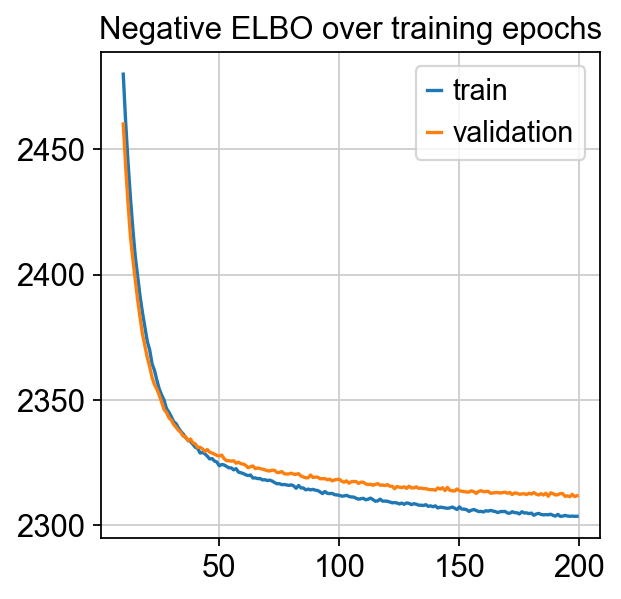

In [19]:
vae_arches_451, vae_q_arches_451, full_data_arches = processing_online_model(vae_q_451, vae_ref_451, adata_ref, adata_query)

In [20]:
full_data_arches.obs["seurat_clusters"]

3228_AAAGTAGAGCTACCGC-1      NKG2Cpos
3228_AAATGCCCAGATGGGT-1       CD56dim
3228_AAGACCTCATTCGACA-1           ML2
3228_ACACTGATCAGGTTCA-1       CD56dim
3228_ACGAGGAGTTACGCGC-1       CD56dim
                              ...    
451_TTTGGTTTCGTATCAG-1        CD56dim
451_TTTGTCAAGACCTTTG-1        CD56dim
451_TTTGTCAGTCTAGTCA-1        CD56dim
451_TTTGTCAGTTACAGAA-1     CD56bright
451_TTTGTCATCGCCATAA-1     CD56bright
Name: seurat_clusters, Length: 20046, dtype: object

In [21]:
full_data_arches.obs["celltype.l2"]

3228_AAAGTAGAGCTACCGC-1    NKG2Cpos
3228_AAATGCCCAGATGGGT-1     CD56dim
3228_AAGACCTCATTCGACA-1         ML2
3228_ACACTGATCAGGTTCA-1     CD56dim
3228_ACGAGGAGTTACGCGC-1     CD56dim
                             ...   
451_TTTGGTTTCGTATCAG-1          ML2
451_TTTGTCAAGACCTTTG-1          ML1
451_TTTGTCAGTCTAGTCA-1          ML2
451_TTTGTCAGTTACAGAA-1      CD56dim
451_TTTGTCATCGCCATAA-1      CD56dim
Name: celltype.l2, Length: 20046, dtype: object

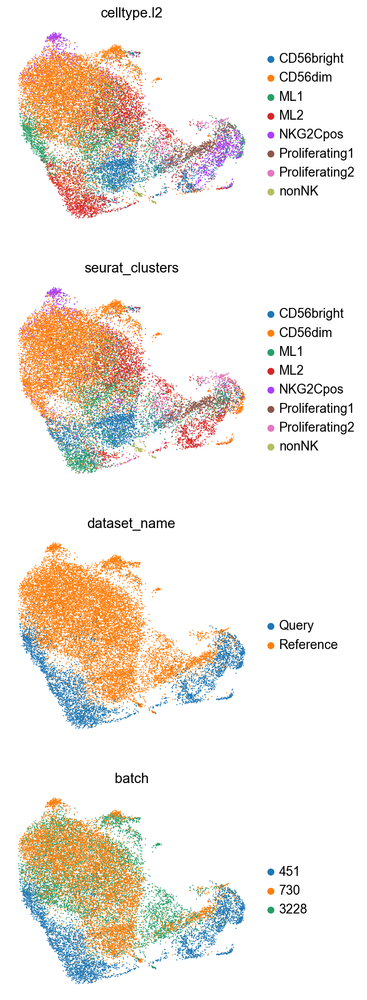

In [22]:
sc.pl.umap(
    full_data_arches,
    color=["celltype.l2", "seurat_clusters", "dataset_name", "batch"],
    frameon=False,
    ncols=1,
    size=5,
)

In [23]:
print("Acc: {}".format(np.mean(full_data_arches.obs["seurat_clusters"] == full_data_arches.obs["celltype.l2"])))

Acc: 0.8135787688316871


In [24]:
full_data_arches.obs["celltype.l2"] = full_data_arches.obs["celltype.l2"].astype("category")

In [25]:
full_data_arches

AnnData object with n_obs × n_vars = 20046 × 4000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'species', 'nCount_ADT', 'nFeature_ADT', 'nCount_HTO', 'nFeature_HTO', 'percent.mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_species', 'Cell_Types', 'S.Score', 'G2M.Score', 'Phase', 'RNA_snn_res.0.2', 'seurat_clusters', 'unfilt_clusters', 'RNA.weight', 'ADT_denoised_iso_quant.weight', 'celltype.l2', 'batch', '_scvi_labels', '_scvi_batch', 'dataset_name'
    uns: '_scvi_uuid', '_scvi_manager_uuid', 'neighbors', 'umap', 'celltype.l2_colors', 'seurat_clusters_colors', 'dataset_name_colors', 'batch_colors'
    obsm: 'protein_expression', 'X_totalvi_scarches', 'X_umap'
    obsp: 'distances', 'connectivities'

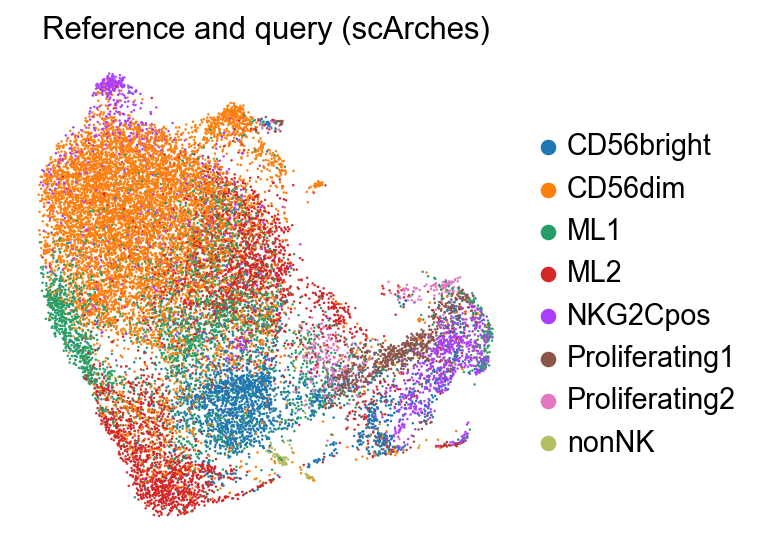

In [26]:
sc.pl.umap(
    full_data_arches,
    color=["celltype.l2"],
    frameon=False,
    ncols=1,
    title="Reference and query (scArches)",
    size=5,
)

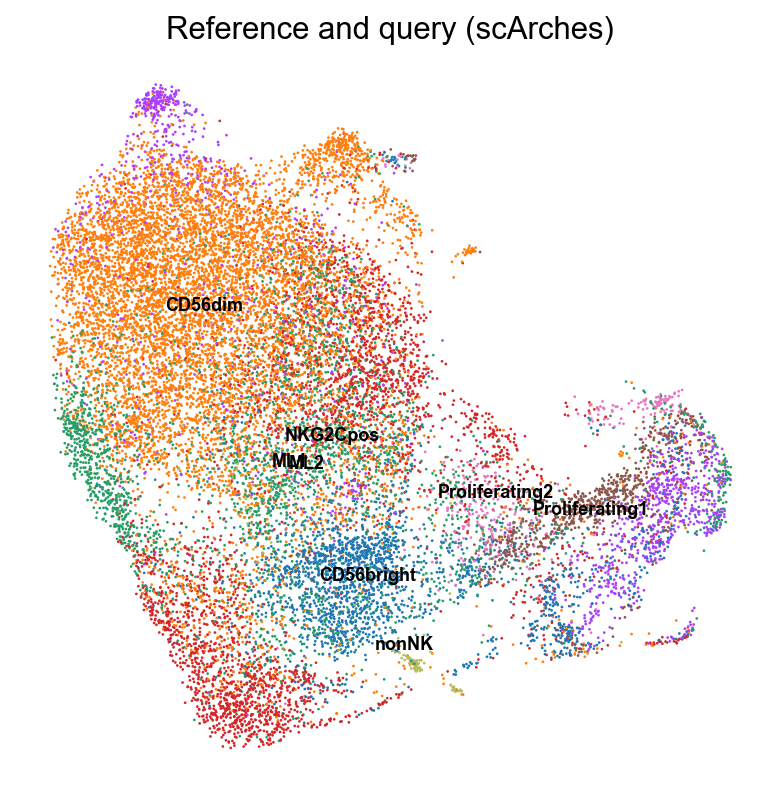

In [27]:
fig, ax = plt.subplots(figsize=(6, 6))
sc.pl.umap(
    full_data_arches,
    color=["celltype.l2"],
    frameon=False,
    ncols=1,
    title="Reference and query (scArches)",
    legend_loc="on data",
    legend_fontsize="xx-small",
    ax=ax,
)


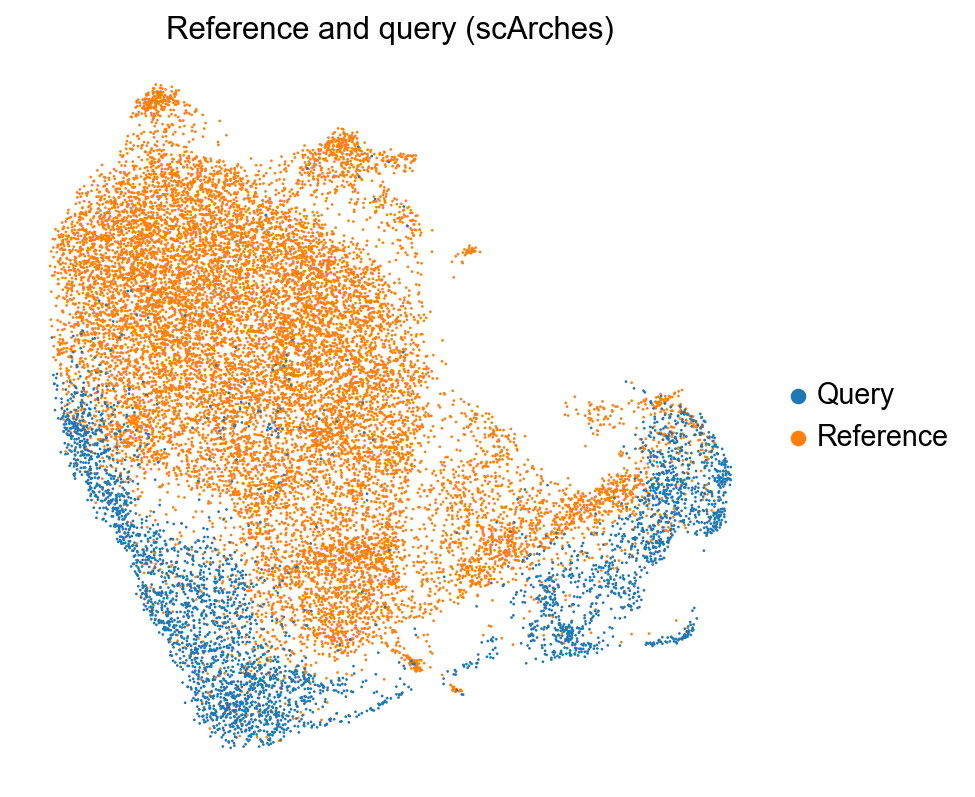

In [28]:
fig, ax = plt.subplots(figsize=(6, 6))
sc.pl.umap(
    full_data_arches,
    color=["dataset_name"],
    frameon=False,
    ncols=1,
    title="Reference and query (scArches)",
    ax=ax,
#     size=5,
)
#fig.savefig("figs/scarches_ref_query.pdf", bbox_inches="tight", dpi=DPI)

#### Using the scarches documentation for running these models

In [29]:
# create the reference
adata_ref = anndata.concat([adata_3228,adata_730])
# separate the query 
adata_query = adata_451
# put matrix of zeros for protein expression (considered missing)
pro_exp = adata_ref.obsm["protein_expression"]
data = np.zeros((adata_query.n_obs, pro_exp.shape[1]))
adata_query.obsm["protein_expression"] = pd.DataFrame(columns=pro_exp.columns, index=adata_query.obs_names, data = data)

# concatenate the objects
adata_full = anndata.concat([adata_ref, adata_query])

sc.pp.highly_variable_genes(
    adata_full,
    n_top_genes=4000,
    flavor="seurat_v3",
    batch_key="batch",
    subset=True,
)

adata_ref = adata_full[np.logical_or(adata_full.obs.batch == "3228", adata_full.obs.batch == "730")].copy()
adata_query = adata_full[adata_full.obs.batch == "451"].copy()
adata_query = adata_query[:, adata_ref.var_names].copy()

In [30]:
vae_ref_451 = sca.models.TOTALVI.load("/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/models/451_query/10-25_run/reference_model", adata=adata_ref)
vae_q_451 = sca.models.TOTALVI.load("/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/models/451_query/10-25_run/query_model", adata=adata_query)

INFO     File                                                                                                      
         /Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/mo
         dels/451_query/10-25_run/reference_model/model.pt already downloaded                                      


INFO     Found batches with missing protein expression                                                             
INFO     Computing empirical prior initialization for protein background.                                          
INFO     File                                                                                                      
         /Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/mo
         dels/451_query/10-25_run/query_model/model.pt already downloaded                                          
INFO     Found batches with missing protein expression                                                             
INFO     Computing empirical prior initialization for protein background.                                          


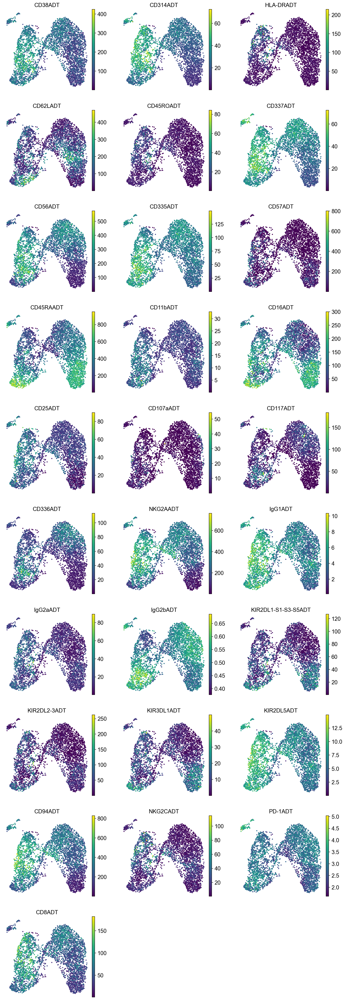

In [31]:
adata_query.obsm["X_totalVI"] = vae_q_451.get_latent_representation()
sc.pp.neighbors(adata_query, use_rep="X_totalVI")
sc.tl.umap(adata_query, min_dist=0.4)

_, imputed_proteins = vae_q_451.get_normalized_expression(
    adata_query,
    n_samples=25,
    return_mean=True,
    transform_batch=["451", "3228", "730"],
)

adata_query.obs = pd.concat([adata_query.obs, imputed_proteins], axis=1)

sc.pl.umap(
    adata_query,
    color=imputed_proteins.columns,
    frameon=False,
    ncols=3,
)


In [32]:
adata_full_new = adata_query.concatenate(adata_ref, batch_key="none")



In [33]:
adata_full_new.obsm["X_totalVI"] = vae_q_451.get_latent_representation(adata_full_new)
sc.pp.neighbors(adata_full_new, use_rep="X_totalVI")
sc.tl.umap(adata_full_new, min_dist=0.3)


INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             
INFO     Found batches with missing protein expression                                                             


In [34]:
_, imputed_proteins_all = vae_q_451.get_normalized_expression(
    adata_full_new,
    n_samples=25,
    return_mean=True,
    transform_batch=["451", "3228", "730"],
)

for i, p in enumerate(imputed_proteins_all.columns):
    adata_full_new.obs[p] = imputed_proteins_all[p].to_numpy().copy()

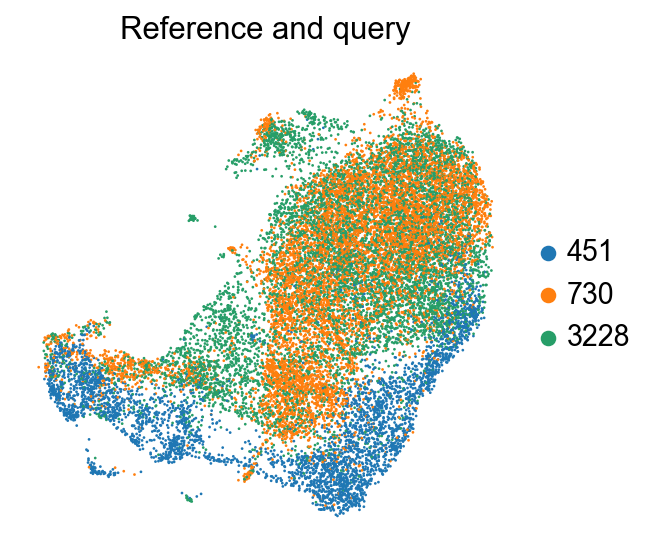

In [35]:
perm_inds = np.random.permutation(np.arange(adata_full_new.n_obs))
sc.pl.umap(
    adata_full_new[perm_inds],
    color=["batch"],
    frameon=False,
    ncols=1,
    title="Reference and query"
)

### Reference 3228, 451. Query 730

In [36]:
# create the reference
adata_ref = anndata.concat([adata_3228,adata_451])
# separate the query 
adata_query = adata_730
# put matrix of zeros for protein expression (considered missing)
pro_exp = adata_ref.obsm["protein_expression"]
data = np.zeros((adata_query.n_obs, pro_exp.shape[1]))
adata_query.obsm["protein_expression"] = pd.DataFrame(columns=pro_exp.columns, index=adata_query.obs_names, data = data)

# concatenate the objects
adata_full = anndata.concat([adata_ref, adata_query])

sc.pp.highly_variable_genes(
    adata_full,
    n_top_genes=4000,
    flavor="seurat_v3",
    batch_key="batch",
    subset=True,
)

adata_ref = adata_full[np.logical_or(adata_full.obs.batch == "3228", adata_full.obs.batch == "451")].copy()
adata_query = adata_full[adata_full.obs.batch == "730"].copy()
adata_query = adata_query[:, adata_ref.var_names].copy()

In [38]:
vae_ref_730 = sca.models.TOTALVI.load("/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/models/730_query/10-25_run/reference_model/", adata=adata_ref)
vae_q_730 = sca.models.TOTALVI.load("/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/models/730_query/10-25_run/query_model/", adata=adata_query)

INFO     File                                                                                                      
         /Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/mo
         dels/730_query/10-25_run/reference_model/model.pt already downloaded                                      


INFO     Found batches with missing protein expression                                                             
INFO     Computing empirical prior initialization for protein background.                                          
INFO     File                                                                                                      
         /Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/mo
         dels/730_query/10-25_run/query_model/model.pt already downloaded                                          
INFO     Found batches with missing protein expression                                                             
INFO     Computing empirical prior initialization for protein background.                                          


In [39]:
vae_ref_730.view_anndata_setup()
vae_q_730.view_anndata_setup()

Anndata setup with scvi-tools version 1.0.3.

Setup via `TOTALVI.setup_anndata` with arguments:

{
│   'protein_expression_obsm_key': 'protein_expression',
│   'protein_names_uns_key': None,
│   'batch_key': 'batch',
│   'layer': None,
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   2   │
│         n_cells          │ 11759 │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│        n_proteins        │  28   │
│          n_vars          │ 4000  │
└──────────────────────────┴───────┘

                   Data Registry                   
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃       scvi-tools Location        ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │             adata.X              │
│    batch     │     adata.obs['_scvi_batch']     │
│    labels    │    adata.obs['_scvi_labels']     │
│   proteins   │ adata.obsm['protein_expression'] │
└──────────────┴──────────────────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

                  batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['batch'] │    3228    │          0          │
│                    │    451     │          1          │
└────────────────────┴────────────┴─────────────────────┘

Anndata setup with scvi-tools version 1.0.3.

Setup via `TOTALVI.setup_anndata` with arguments:

{
│   'protein_expression_obsm_key': 'protein_expression',
│   'protein_names_uns_key': None,
│   'batch_key': 'batch',
│   'layer': None,
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   3   │
│         n_cells          │ 8287  │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│        n_proteins        │  28   │
│          n_vars          │ 4000  │
└──────────────────────────┴───────┘

                   Data Registry                   
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃       scvi-tools Location        ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │             adata.X              │
│    batch     │     adata.obs['_scvi_batch']     │
│    labels    │    adata.obs['_scvi_labels']     │
│   proteins   │ adata.obsm['protein_expression'] │
└──────────────┴──────────────────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

                  batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['batch'] │    3228    │          0          │
│                    │    451     │          1          │
│                    │    730     │          2          │
└────────────────────┴────────────┴─────────────────────┘

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    1.3s finished
[Parallel(n_jobs=12)]: Using backend ThreadingBackend with 12 concurrent workers.
[Parallel(n_jobs=12)]: Done  26 tasks      | elapsed:    0.1s
[Parallel(n_jobs=12)]: Done 100 out of 100 | elapsed:    0.1s finished


Acc: 0.7389887776034754
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     Found batches with missing protein expression                                                             
Computing full umap


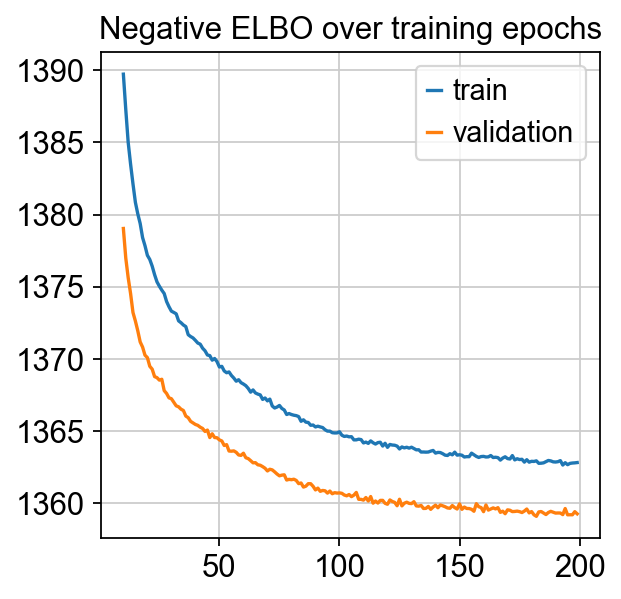

In [41]:
vae_arches_730, vae_q_arches_730, full_data_arches = processing_online_model(vae_q_730, vae_ref_730, adata_ref, adata_query)

In [42]:
full_data_arches.obs["celltype.l2"] = full_data_arches.obs["celltype.l2"].astype("category")

In [43]:
print("Acc: {}".format(np.mean(full_data_arches.obs["seurat_clusters"] == full_data_arches.obs["celltype.l2"])))

Acc: 0.8920981741993416


In [44]:
full_data_arches

AnnData object with n_obs × n_vars = 20046 × 4000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'species', 'nCount_ADT', 'nFeature_ADT', 'nCount_HTO', 'nFeature_HTO', 'percent.mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_species', 'Cell_Types', 'S.Score', 'G2M.Score', 'Phase', 'RNA_snn_res.0.2', 'seurat_clusters', 'unfilt_clusters', 'RNA.weight', 'ADT_denoised_iso_quant.weight', 'celltype.l2', 'batch', '_scvi_labels', '_scvi_batch', 'dataset_name'
    uns: '_scvi_uuid', '_scvi_manager_uuid', 'neighbors', 'umap'
    obsm: 'protein_expression', 'X_totalvi_scarches', 'X_umap'
    obsp: 'distances', 'connectivities'

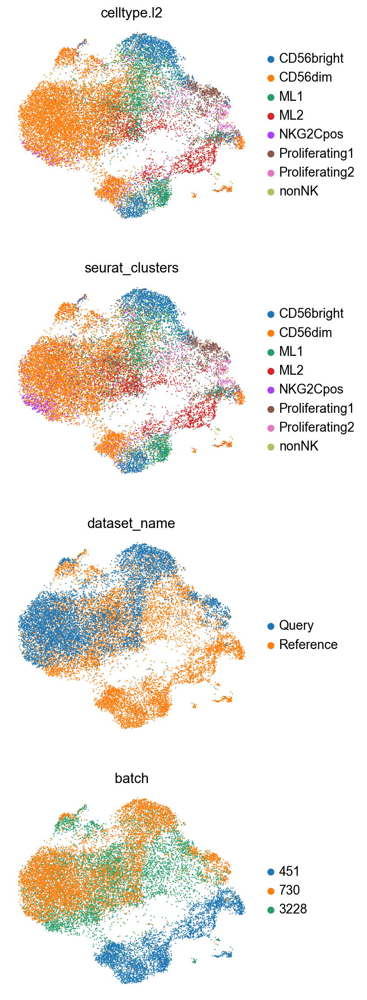

In [45]:
sc.pl.umap(
    full_data_arches,
    color=["celltype.l2", "seurat_clusters", "dataset_name", "batch"],
    frameon=False,
    ncols=1,
    size=5,
)

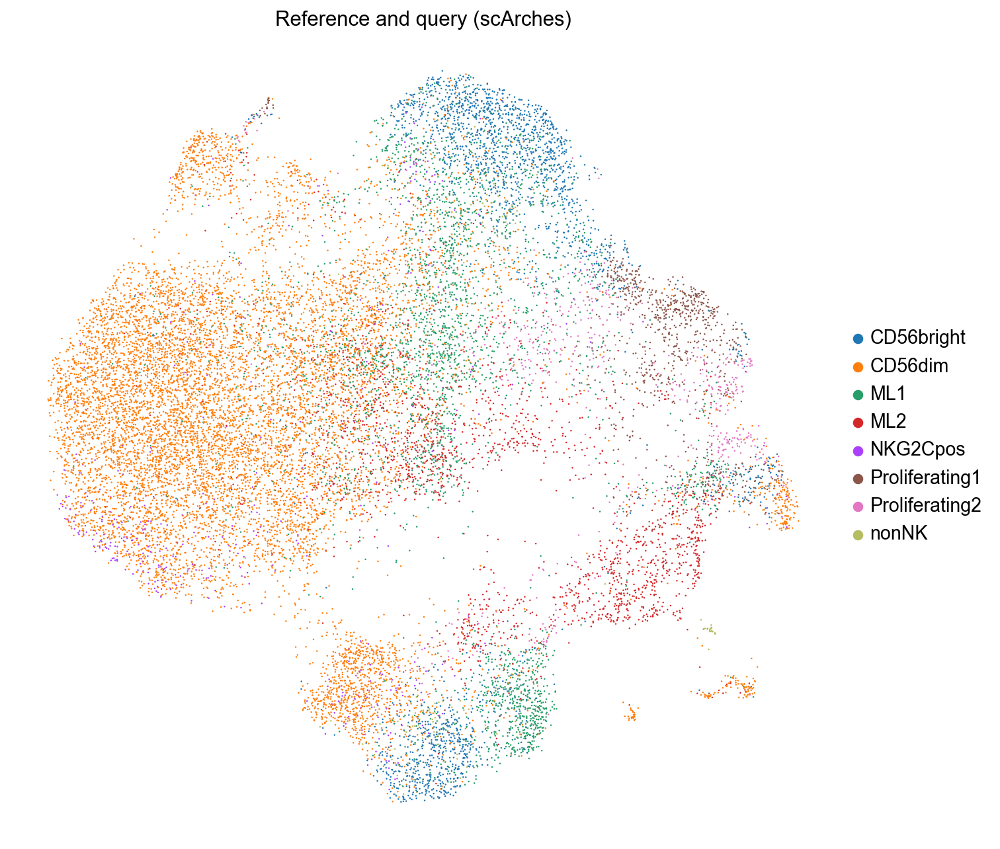

In [46]:
fig, ax = plt.subplots(figsize=(10, 10))
sc.pl.umap(
    full_data_arches,
    color=["celltype.l2"],
    frameon=False,
    ncols=1,
    title="Reference and query (scArches)",
    ax=ax,
    size=5,
)

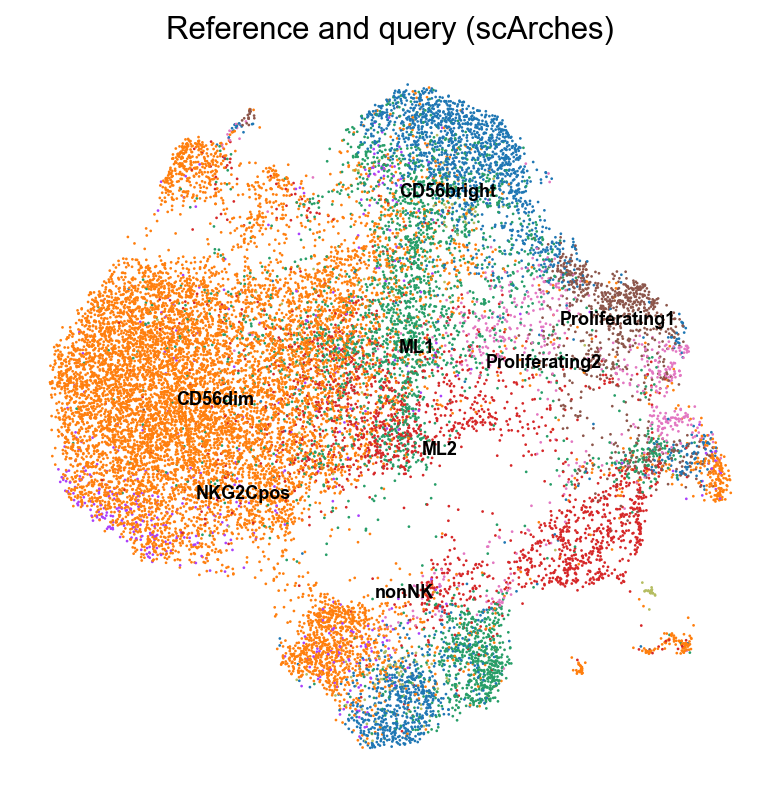

In [47]:
fig, ax = plt.subplots(figsize=(6, 6))
sc.pl.umap(
    full_data_arches,
    color=["celltype.l2"],
    frameon=False,
    ncols=1,
    title="Reference and query (scArches)",
    legend_loc="on data",
    legend_fontsize="xx-small",
#     legend_fontoutline=1,
    ax=ax,
#     size=5,
)
#fig.savefig("figs/scarches_ref_query_by_cell_type.pdf", bbox_inches="tight", dpi=DPI)

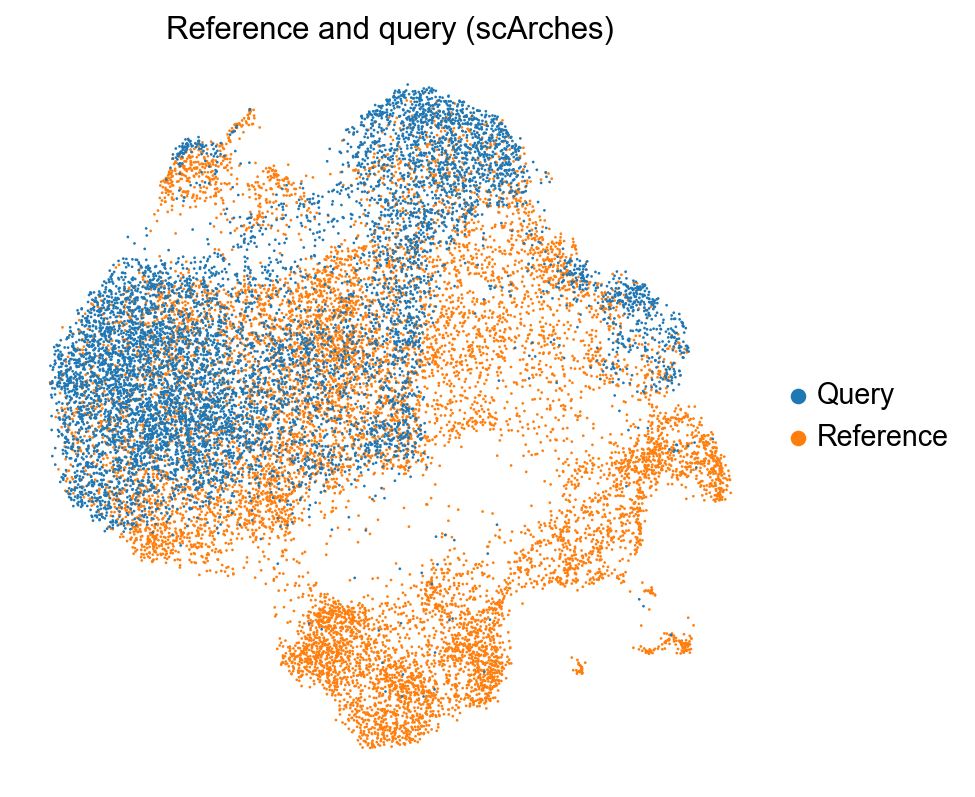

In [48]:
fig, ax = plt.subplots(figsize=(6, 6))
sc.pl.umap(
    full_data_arches,
    color=["dataset_name"],
    frameon=False,
    ncols=1,
    title="Reference and query (scArches)",
    ax=ax,
#     size=5,
)
#fig.savefig("figs/scarches_ref_query.pdf", bbox_inches="tight", dpi=DPI)

### Reference 451, 730. Query 3228

In [49]:
# create the reference
adata_ref = anndata.concat([adata_451,adata_730])
# separate the query 
adata_query = adata_3228
# put matrix of zeros for protein expression (considered missing)
pro_exp = adata_ref.obsm["protein_expression"]
data = np.zeros((adata_query.n_obs, pro_exp.shape[1]))
adata_query.obsm["protein_expression"] = pd.DataFrame(columns=pro_exp.columns, index=adata_query.obs_names, data = data)

# concatenate the objects
adata_full = anndata.concat([adata_ref, adata_query])

sc.pp.highly_variable_genes(
    adata_full,
    n_top_genes=4000,
    flavor="seurat_v3",
    batch_key="batch",
    subset=True,
)

adata_ref = adata_full[np.logical_or(adata_full.obs.batch == "451", adata_full.obs.batch == "730")].copy()
adata_query = adata_full[adata_full.obs.batch == "3228"].copy()
adata_query = adata_query[:, adata_ref.var_names].copy()

In [51]:
vae_ref_3228 = sca.models.TOTALVI.load("/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/models/3228_query/10-25_run/reference_model", adata=adata_ref)
vae_q_3228 = sca.models.TOTALVI.load("/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/models/3228_query/10-25_run/query_model", adata=adata_query)

INFO     File                                                                                                      
         /Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/mo
         dels/3228_query/10-25_run/reference_model/model.pt already downloaded                                     


INFO     Found batches with missing protein expression                                                             
INFO     Computing empirical prior initialization for protein background.                                          
INFO     File                                                                                                      
         /Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/mo
         dels/3228_query/10-25_run/query_model/model.pt already downloaded                                         
INFO     Found batches with missing protein expression                                                             
INFO     Computing empirical prior initialization for protein background.                                          


In [52]:
vae_ref_3228.view_anndata_setup()
vae_q_3228.view_anndata_setup()

Anndata setup with scvi-tools version 1.0.3.

Setup via `TOTALVI.setup_anndata` with arguments:

{
│   'protein_expression_obsm_key': 'protein_expression',
│   'protein_names_uns_key': None,
│   'batch_key': 'batch',
│   'layer': None,
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   2   │
│         n_cells          │ 12232 │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│        n_proteins        │  28   │
│          n_vars          │ 4000  │
└──────────────────────────┴───────┘

                   Data Registry                   
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃       scvi-tools Location        ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │             adata.X              │
│    batch     │     adata.obs['_scvi_batch']     │
│    labels    │    adata.obs['_scvi_labels']     │
│   proteins   │ adata.obsm['protein_expression'] │
└──────────────┴──────────────────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

                  batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['batch'] │    451     │          0          │
│                    │    730     │          1          │
└────────────────────┴────────────┴─────────────────────┘

Anndata setup with scvi-tools version 1.0.3.

Setup via `TOTALVI.setup_anndata` with arguments:

{
│   'protein_expression_obsm_key': 'protein_expression',
│   'protein_names_uns_key': None,
│   'batch_key': 'batch',
│   'layer': None,
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   3   │
│         n_cells          │ 7814  │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│        n_proteins        │  28   │
│          n_vars          │ 4000  │
└──────────────────────────┴───────┘

                   Data Registry                   
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃       scvi-tools Location        ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │             adata.X              │
│    batch     │     adata.obs['_scvi_batch']     │
│    labels    │    adata.obs['_scvi_labels']     │
│   proteins   │ adata.obsm['protein_expression'] │
└──────────────┴──────────────────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

                  batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['batch'] │    451     │          0          │
│                    │    730     │          1          │
│                    │    3228    │          2          │
└────────────────────┴────────────┴─────────────────────┘

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    1.0s finished
[Parallel(n_jobs=12)]: Using backend ThreadingBackend with 12 concurrent workers.
[Parallel(n_jobs=12)]: Done  26 tasks      | elapsed:    0.0s
[Parallel(n_jobs=12)]: Done 100 out of 100 | elapsed:    0.0s finished


Acc: 0.05157409777322754
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     Found batches with missing protein expression                                                             
Computing full umap


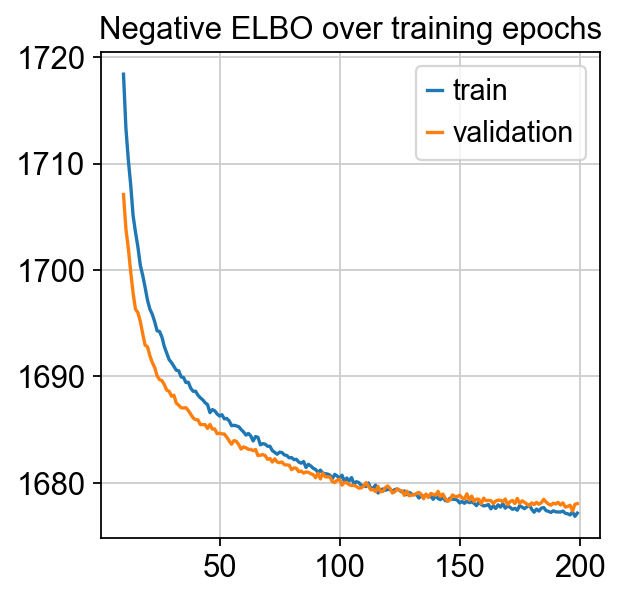

In [53]:
vae_arches_3228, vae_q_arches_3228, full_data_arches = processing_online_model(vae_q_3228, vae_ref_3228, adata_ref, adata_query)

In [54]:
full_data_arches.obs["celltype.l2"] = full_data_arches.obs["celltype.l2"].astype("category")

In [55]:
print("Acc: {}".format(np.mean(full_data_arches.obs["seurat_clusters"] == full_data_arches.obs["celltype.l2"])))

Acc: 0.6303003092886361


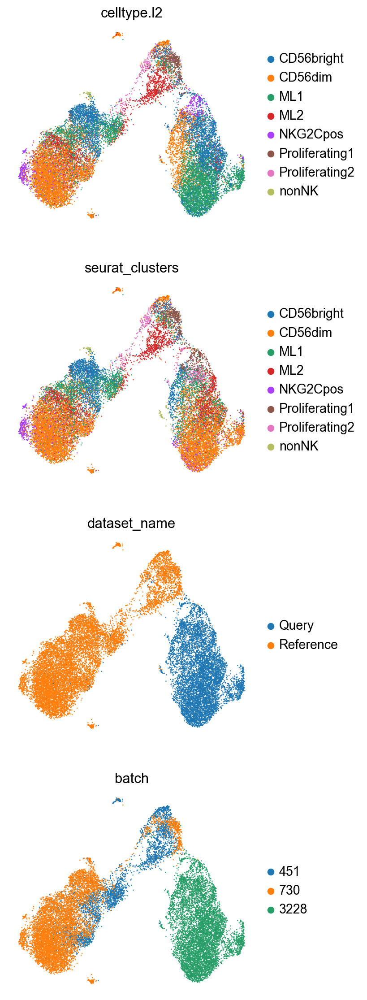

In [56]:
sc.pl.umap(
    full_data_arches,
    color=["celltype.l2", "seurat_clusters", "dataset_name", "batch"],
    frameon=False,
    ncols=1,
    size=5,
)

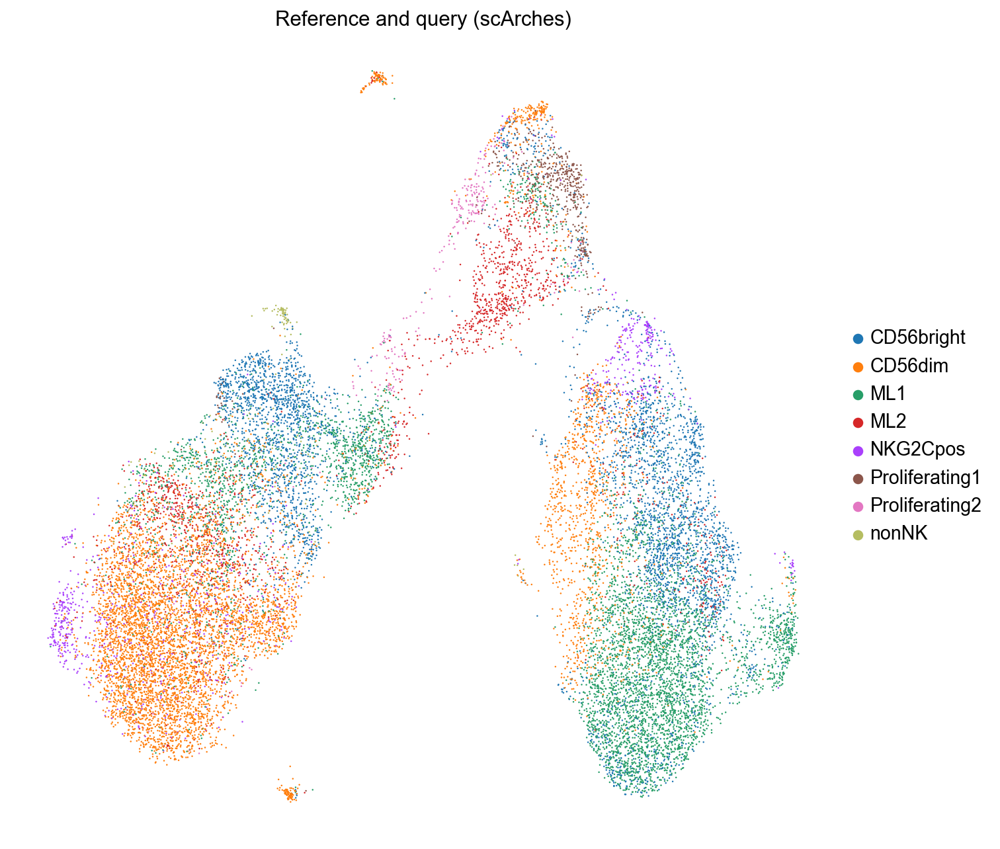

In [57]:
fig, ax = plt.subplots(figsize=(10, 10))
sc.pl.umap(
    full_data_arches,
    color=["celltype.l2"],
    frameon=False,
    ncols=1,
    title="Reference and query (scArches)",
    ax=ax,
    size=5,
)

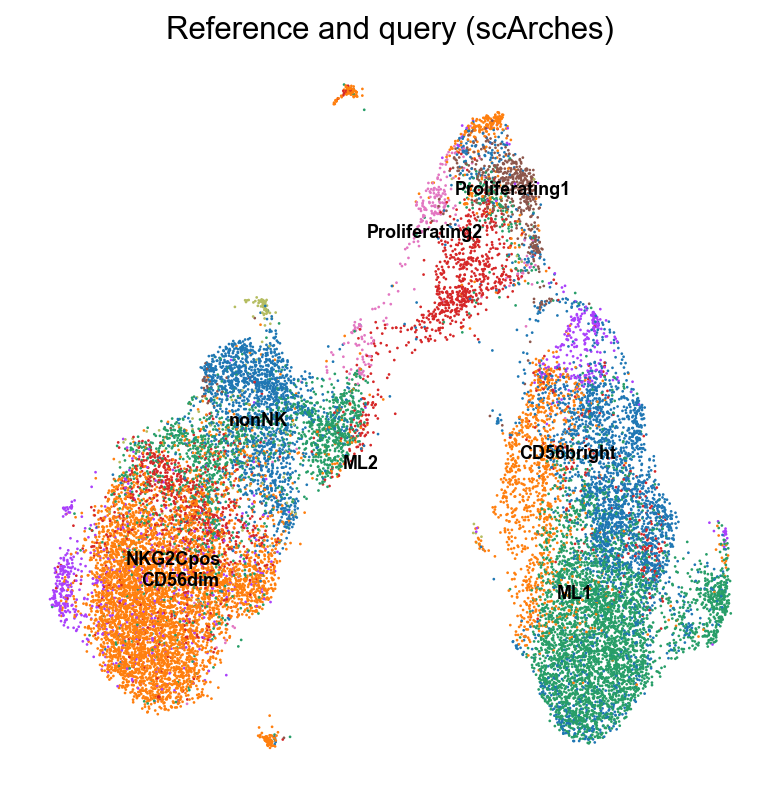

In [58]:
fig, ax = plt.subplots(figsize=(6, 6))
sc.pl.umap(
    full_data_arches,
    color=["celltype.l2"],
    frameon=False,
    ncols=1,
    title="Reference and query (scArches)",
    legend_loc="on data",
    legend_fontsize="xx-small",
#     legend_fontoutline=1,
    ax=ax,
#     size=5,
)
#fig.savefig("figs/scarches_ref_query_by_cell_type.pdf", bbox_inches="tight", dpi=DPI)

In [ ]:
fig, ax = plt.subplots(figsize=(6, 6))
sc.pl.umap(
    full_data_arches,
    color=["dataset_name"],
    frameon=False,
    ncols=1,
    title="Reference and query (scArches)",
    ax=ax,
#     size=5,
)
#fig.savefig("figs/scarches_ref_query.pdf", bbox_inches="tight", dpi=DPI)

## 5' Data as Query

#### This code creates a reference model from the query data. We want to create 

In [59]:
adata = sc.read('/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/data/fig4_data/adata/fig4_Protein_folzconversion.h5ad')
adata.layers["counts"] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata

In [90]:
query = sc.read('/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/data/fig7_data/adata/Protein_5prime_foltz.h5ad')

Make sure the genes in both the reference and query are the same. 

In [62]:
'''
x = adata.var_names
y = query.var_names

z = x.intersection(y)
'''

'\nx = adata.var_names\ny = query.var_names\n\nz = x.intersection(y)\n'

In [63]:
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=4000,
    flavor="seurat_v3",
    batch_key="orig.ident",
    subset=True,
    layer="counts",
)

In [64]:
TOTALVI.setup_anndata(
    adata,
    layer="counts",
    batch_key="orig.ident",
    protein_expression_obsm_key="protein_expression",
)

INFO     Using column names from columns of adata.obsm['protein_expression']                                       
INFO     Found batches with missing protein expression                                                             


In [65]:
# # training code here
'''
arches_params = dict(
    use_layer_norm="both",
    use_batch_norm="none",
    n_layers_decoder=2,
    n_layers_encoder=2,
)

vae = TOTALVI(adata, **arches_params)
vae.train(max_epochs=250)
vae.save("/storage1/fs1/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/conversion/TOTALVI/offline_default_model", overwrite=True)
'''

'\narches_params = dict(\n    use_layer_norm="both",\n    use_batch_norm="none",\n    n_layers_decoder=2,\n    n_layers_encoder=2,\n)\n\nvae = TOTALVI(adata, **arches_params)\nvae.train(max_epochs=250)\nvae.save("/storage1/fs1/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/conversion/TOTALVI/offline_default_model", overwrite=True)\n'

In [66]:
adata

AnnData object with n_obs × n_vars = 20046 × 4000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'species', 'nCount_ADT', 'nFeature_ADT', 'nCount_HTO', 'nFeature_HTO', 'percent.mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_species', 'Cell_Types', 'S.Score', 'G2M.Score', 'Phase', 'RNA_snn_res.0.2', 'seurat_clusters', 'unfilt_clusters', 'RNA.weight', 'ADT_denoised_iso_quant.weight', '_scvi_labels', '_scvi_batch'
    var: 'mouse', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'hvg', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: 'protein_expression'
    layers: 'counts'

In [67]:
vae = sca.models.TOTALVI.load("/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/models/full_model/10-26_run/offline_default_model", adata=adata)

INFO     File                                                                                                      
         /Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/mo
         dels/full_model/10-26_run/offline_default_model/model.pt already downloaded                               


INFO     Found batches with missing protein expression                                                             
INFO     Computing empirical prior initialization for protein background.                                          


In [68]:
vae.view_anndata_setup()

Anndata setup with scvi-tools version 1.0.3.

Setup via `TOTALVI.setup_anndata` with arguments:

{
│   'protein_expression_obsm_key': 'protein_expression',
│   'protein_names_uns_key': None,
│   'batch_key': 'orig.ident',
│   'layer': 'counts',
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   3   │
│         n_cells          │ 20046 │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│        n_proteins        │  28   │
│          n_vars          │ 4000  │
└──────────────────────────┴───────┘

                   Data Registry                   
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃       scvi-tools Location        ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │      adata.layers['counts']      │
│    batch     │     adata.obs['_scvi_batch']     │
│    labels    │    adata.obs['_scvi_labels']     │
│   proteins   │ adata.obsm['protein_expression'] │
└──────────────┴──────────────────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

                     batch State Registry                     
┏━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃     Source Location     ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['orig.ident'] │    451     │          0          │
│                         │    730     │          1          │
│                         │    3228    │          2          │
└─────────────────────────┴────────────┴─────────────────────┘

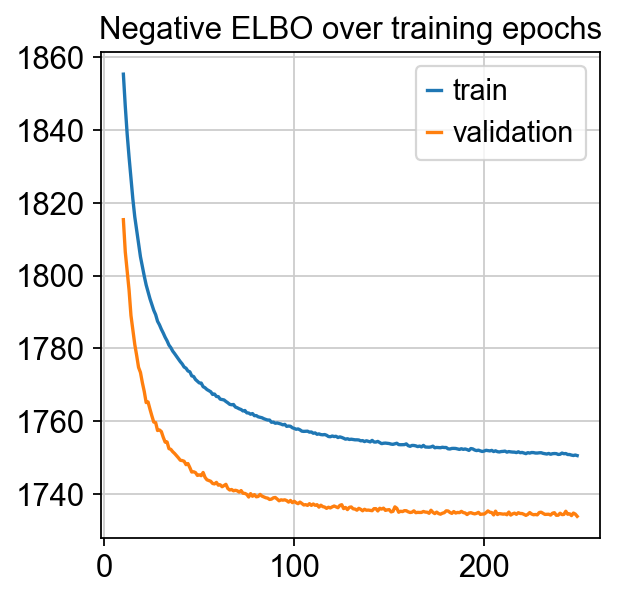

In [69]:
plt.plot(vae.history["elbo_train"].iloc[10:], label="train")
plt.plot(vae.history["elbo_validation"].iloc[10:], label="validation")
plt.title("Negative ELBO over training epochs")
plt.legend()

In [70]:
adata.obsm["X_totalvi_scarches"] = vae.get_latent_representation()

In [71]:
adata.obs["seurat_clusters"]

730_AAACCTGAGCCCAACC-1     1
730_AAACCTGAGTACCGGA-1     0
730_AAACCTGCAAGCTGTT-1     3
730_AAACCTGCACGAGGTA-1     0
730_AAACCTGCATGATCCA-1     2
                          ..
451_TTTGTCATCGCCATAA-1     3
3228_ACTGAGTGTTACGACT-1    3
3228_CAGAATCAGCACCGTC-1    2
3228_GCGCGATTCACGGTTA-1    2
3228_TCGGGACCACGCATCG-1    0
Name: seurat_clusters, Length: 20046, dtype: int64

In [72]:
adata.obs["celltype.l2"] = adata.obs["seurat_clusters"].replace({
    0: "CD56dim",
    1: "ML1",
    2: "ML2",
    3: "CD56bright",
    4: "CD56dim",
    5: "NKG2Cpos",
    6: "Proliferating1",
    7: "CD56dim",
    8: "Proliferating2",
    9: "nonNK"
})

In [73]:
adata.obs["celltype.l2"]

730_AAACCTGAGCCCAACC-1            ML1
730_AAACCTGAGTACCGGA-1        CD56dim
730_AAACCTGCAAGCTGTT-1     CD56bright
730_AAACCTGCACGAGGTA-1        CD56dim
730_AAACCTGCATGATCCA-1            ML2
                              ...    
451_TTTGTCATCGCCATAA-1     CD56bright
3228_ACTGAGTGTTACGACT-1    CD56bright
3228_CAGAATCAGCACCGTC-1           ML2
3228_GCGCGATTCACGGTTA-1           ML2
3228_TCGGGACCACGCATCG-1       CD56dim
Name: celltype.l2, Length: 20046, dtype: object

In [74]:
y_train = adata.obs["celltype.l2"].astype("category").cat.codes.to_numpy()
X_train = adata.obsm["X_totalvi_scarches"]
clf = RandomForestClassifier(
    random_state=1,
    class_weight="balanced_subsample",
    verbose=1,
    n_jobs=-1,
)
clf.fit(X_train, y_train)

vae.latent_space_classifer_ = clf

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    2.2s finished


In [75]:
adata.obsm

AxisArrays with keys: protein_expression, X_totalvi_scarches

In [76]:
import umap


In [77]:
X = adata.obsm["X_totalvi_scarches"]
trans = umap.UMAP(
    n_neighbors=10,
    random_state=42,
    min_dist=0.4,
)
adata.obsm["X_umap"] = trans.fit_transform(X)

vae.umap_op_ = trans

In [78]:
# I wonder if this would effect the model since its run on a continuous variable instead of a cateogrical one
adata.obs["orig.ident"] = adata.obs["orig.ident"].astype("category")


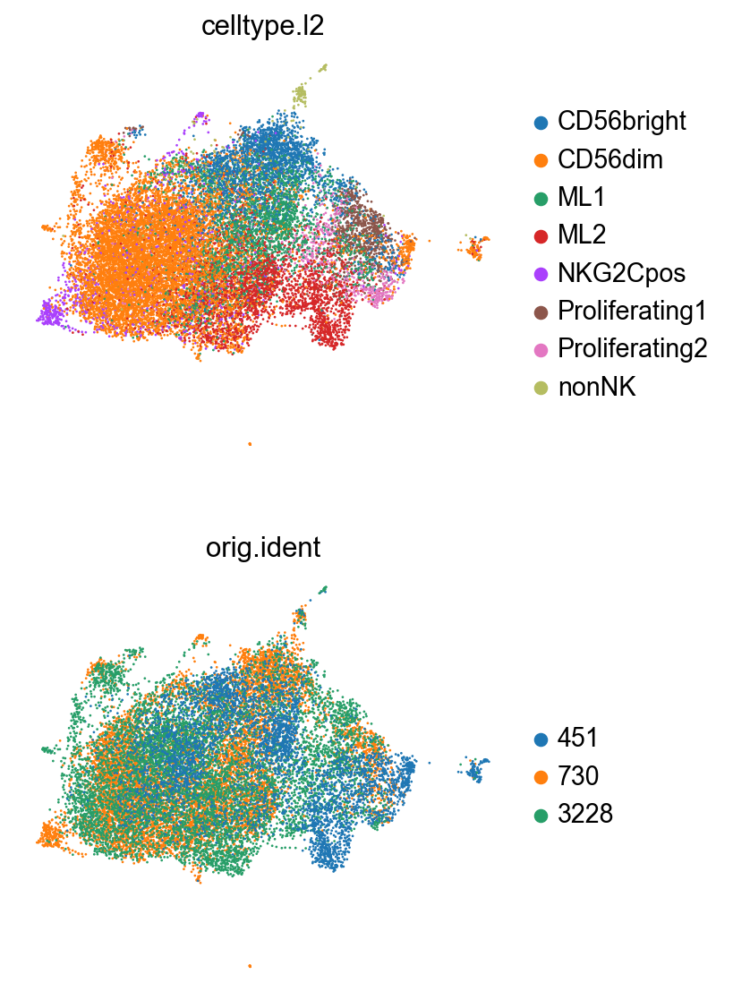

In [79]:
sc.pl.umap(
    adata,
    color=["celltype.l2", "orig.ident"],
    frameon=False,
    ncols=1,
)

#### Map query data

In [91]:
query

AnnData object with n_obs × n_vars = 12646 × 15545
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'species', 'nCount_ADT', 'nFeature_ADT', 'nCount_HTO', 'nFeature_HTO', 'percent.mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_species', 'Cell_Types', 'Donor', 'S.Score', 'G2M.Score', 'Phase', 'RNA_snn_res.0.8', 'seurat_clusters', 'unfiltered_clusters', 'unfiltered_classifications', 'Cell_TypesF', 'RNA.weight', 'ADT_denoised_iso_quant.weight', 'nCount_ADT_denoised_iso', 'nFeature_ADT_denoised_iso', 'nCount_ADT_denoised_iso_quant', 'nFeature_ADT_denoised_iso_quant'
    var: 'mouse', 'n_cells'
    obsm: 'protein_expression'

In [93]:
query.layers["counts"] = query.X

In [94]:
sc.pp.highly_variable_genes(
    query,
    n_top_genes=4000,
    flavor="seurat_v3",
    batch_key="orig.ident",
    subset=True,
    layer="counts",
)

In [95]:
query.var_names

Index(['SAMD11', 'HES4', 'ISG15', 'AGRN', 'TNFRSF18', 'TNFRSF4', 'C1QTNF12',
       'TAS1R3', 'ATAD3A', 'FNDC10',
       ...
       'AP001469.3', 'C21orf58', 'PCNT', 'MT-ND1', 'MT-CO2', 'MT-CO3',
       'MT-ND4', 'MT-ND6', 'MT-CYB', 'AC004556.1'],
      dtype='object', length=4000)

In [96]:
adata.var_names

Index(['AGRN', 'TTLL10', 'TNFRSF18', 'TNFRSF4', 'AL162741.1', 'ATAD3B',
       'ATAD3A', 'TMEM240', 'FO704657.1', 'AL139246.3',
       ...
       'MT-ND1', 'MT-ND2', 'MT-CO1', 'MT-CO2', 'MT-ATP8', 'MT-ATP6', 'MT-CO3',
       'MT-ND5', 'MT-ND6', 'AC145212.1'],
      dtype='object', length=4000)

In [97]:
# Store the counts in a layer, perform standard preprocessing
query.layers["counts"] = query.X.copy()
sc.pp.normalize_total(query, target_sum=1e4)
sc.pp.log1p(query)
query.raw = query
# subset to reference vars
# query = query[:, z].copy() 

# Add blank metadata that we will later fill in with predicted labels
query.obsm["protein_counts"] = query.obsm["protein_expression"].copy()
query.obs["celltype.l2"] = "Unknown"
# query.obs["orig.ident"] = query.obs["set"] # Rename the batch key to correspond to the reference data, 
# I don't think we need to do this becasue the batch key already exsists in the same slot as the reference data
# query.obsm["X_umap"] = query.obs[["UMAP1", "UMAP2"]].values
# there is no umap info in my data set


# reorganize query proteins, missing proteins become all 0
for p in adata.obsm["protein_expression"].columns:
    if p not in query.obsm["protein_counts"].columns:
        query.obsm["protein_counts"][p] = 0.0
# ensure columns are in same order
query.obsm["protein_counts"] = query.obsm["protein_counts"].loc[
    :, adata.obsm["protein_expression"].columns
]

In [98]:
adata.obs["dataset_name"] = "Reference"
query.obs["dataset_name"] = "Query"

In [99]:
# train model
'''
vae_q = TOTALVI.load_query_data(
    query,
    vae,
)

start = time.time()
vae_q.train(
    max_epochs=150,
    plan_kwargs=dict(weight_decay=0.0, scale_adversarial_loss=0.0),
)
end = time.time()
print("\n Total query train time: {}".format(end-start))


vae_q.save("/storage1/fs1/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/conversion/TOTALVI/5_prime/5_prime_model_query", overwrite=True)
'''

'\nvae_q = TOTALVI.load_query_data(\n    query,\n    vae,\n)\n\nstart = time.time()\nvae_q.train(\n    max_epochs=150,\n    plan_kwargs=dict(weight_decay=0.0, scale_adversarial_loss=0.0),\n)\nend = time.time()\nprint("\n Total query train time: {}".format(end-start))\n\n\nvae_q.save("/storage1/fs1/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/conversion/TOTALVI/5_prime/5_prime_model_query", overwrite=True)\n'

In [100]:
# Total query train time: 4155.922892093658

In [101]:
query

AnnData object with n_obs × n_vars = 12646 × 4000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'species', 'nCount_ADT', 'nFeature_ADT', 'nCount_HTO', 'nFeature_HTO', 'percent.mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_species', 'Cell_Types', 'Donor', 'S.Score', 'G2M.Score', 'Phase', 'RNA_snn_res.0.8', 'seurat_clusters', 'unfiltered_clusters', 'unfiltered_classifications', 'Cell_TypesF', 'RNA.weight', 'ADT_denoised_iso_quant.weight', 'nCount_ADT_denoised_iso', 'nFeature_ADT_denoised_iso', 'nCount_ADT_denoised_iso_quant', 'nFeature_ADT_denoised_iso_quant', 'celltype.l2', 'dataset_name'
    var: 'mouse', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'hvg', 'log1p'
    obsm: 'protein_expression', 'protein_counts'
    layers: 'counts'

In [102]:
vae_q = TOTALVI.load("/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/models/full_model/10-26_run/fig7_model_query", adata=query)

INFO     File                                                                                                      
         /Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/TOTALVI/mo
         dels/full_model/10-26_run/fig7_model_query/model.pt already downloaded                                    


INFO     Computing empirical prior initialization for protein background.                                          


In [103]:
query.obsm["X_totalvi_scarches"] = vae_q.get_latent_representation(query)

In [104]:
query

AnnData object with n_obs × n_vars = 12646 × 4000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'species', 'nCount_ADT', 'nFeature_ADT', 'nCount_HTO', 'nFeature_HTO', 'percent.mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_species', 'Cell_Types', 'Donor', 'S.Score', 'G2M.Score', 'Phase', 'RNA_snn_res.0.8', 'seurat_clusters', 'unfiltered_clusters', 'unfiltered_classifications', 'Cell_TypesF', 'RNA.weight', 'ADT_denoised_iso_quant.weight', 'nCount_ADT_denoised_iso', 'nFeature_ADT_denoised_iso', 'nCount_ADT_denoised_iso_quant', 'nFeature_ADT_denoised_iso_quant', 'celltype.l2', 'dataset_name', '_scvi_labels', '_scvi_batch'
    var: 'mouse', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'hvg', 'log1p', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: 'protein_expression', 'protein_counts', 'X_totalvi_scarches'
    layers: '

In [105]:
vae_q.is_trained

True

In [106]:
# predict cell types of query

# vae_q does not have latent_space_classifer_ as an attribute but vae does, perhaps this was a mistake??
predictions = vae.latent_space_classifer_.predict(query.obsm["X_totalvi_scarches"])

[Parallel(n_jobs=12)]: Using backend ThreadingBackend with 12 concurrent workers.
[Parallel(n_jobs=12)]: Done  26 tasks      | elapsed:    0.1s
[Parallel(n_jobs=12)]: Done 100 out of 100 | elapsed:    0.2s finished


In [107]:
predictions

array([1, 1, 3, 1, 3, 1, 1, ..., 2, 1, 1, 1, 1, 1, 1], dtype=int8)

In [108]:
categories = adata.obs["celltype.l2"].astype("category").cat.categories
cat_preds = [categories[i] for i in predictions]
query.obs["celltype.l2"] = cat_preds
query.obs["predicted_l2_scarches"] = cat_preds

In [109]:
sc.pp.neighbors(query, use_rep="X_totalvi_scarches", metric="cosine")
sc.tl.umap(query, min_dist=0.3)

In [111]:
test = sc.read('/Volumes/mgriffit/Active/griffithlab/gc2596/e.schmidt/fig4_foltz/SingleCell_ProbabilisticModels/data/fig7_data/adata/fig7_k562_pagaobject3223withleiden31423pagaonleidenclusters_RAW.h5ad')

In [112]:
test.obs['leiden'] # use these clusters

56546_tube1_AAACCTGCACGGCGTT-1     5
56546_tube1_AAACCTGTCAACGAAA-1     5
56546_tube1_AAAGATGAGACGCTTT-1     9
56546_tube1_AAAGATGTCATTATCC-1    13
56546_tube1_AAAGCAAAGGCTCTTA-1     9
                                  ..
9792_ML_TTCGAAGCAGGGATTG-1        10
9792_ML_TTGCCGTTCAGAAATG-1        10
9792_ML_TTGGAACGTTAAAGAC-1        10
9792_ML_TTTATGCTCCCATTTA-1        10
9792_ML_TTTCCTCAGGGCTCTC-1        10
Name: leiden, Length: 12646, dtype: category
Categories (18, object): ['0', '1', '2', '3', ..., '14', '15', '16', '17']

In [113]:
query.obs.columns

Index(['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'species', 'nCount_ADT',
       'nFeature_ADT', 'nCount_HTO', 'nFeature_HTO', 'percent.mt', 'HTO_maxID',
       'HTO_secondID', 'HTO_margin', 'HTO_classification',
       'HTO_classification.global', 'hash.ID', 'HTO_classification_species',
       'Cell_Types', 'Donor', 'S.Score', 'G2M.Score', 'Phase',
       'RNA_snn_res.0.8', 'seurat_clusters', 'unfiltered_clusters',
       'unfiltered_classifications', 'Cell_TypesF', 'RNA.weight',
       'ADT_denoised_iso_quant.weight', 'nCount_ADT_denoised_iso',
       'nFeature_ADT_denoised_iso', 'nCount_ADT_denoised_iso_quant',
       'nFeature_ADT_denoised_iso_quant', 'celltype.l2', 'dataset_name',
       '_scvi_labels', '_scvi_batch', 'predicted_l2_scarches'],
      dtype='object')

In [114]:
query.obs["celltype.l2"]

56546_tube1_AAACCTGCACGGCGTT-1    CD56dim
56546_tube1_AAACCTGTCAACGAAA-1    CD56dim
56546_tube1_AAAGATGAGACGCTTT-1        ML2
56546_tube1_AAAGATGTCATTATCC-1    CD56dim
56546_tube1_AAAGCAAAGGCTCTTA-1        ML2
                                   ...   
9792_ML_TTCGAAGCAGGGATTG-1        CD56dim
9792_ML_TTGCCGTTCAGAAATG-1        CD56dim
9792_ML_TTGGAACGTTAAAGAC-1        CD56dim
9792_ML_TTTATGCTCCCATTTA-1        CD56dim
9792_ML_TTTCCTCAGGGCTCTC-1        CD56dim
Name: celltype.l2, Length: 12646, dtype: object

In [115]:
query.obs["seurat_clusters"] = query.obs["seurat_clusters"].replace({
        0: "CD56dim",
        1: "ML1",
        2: "ML2",
        3: "CD56bright",
        4: "CD56dim",
        5: "NKG2Cpos",
        6: "Proliferating1",
        7: "CD56dim",
        8: "Proliferating2",
        9: "nonNK"
    })

In [116]:
query.obs["seurat_clusters"] = query.obs["seurat_clusters"].astype("category")

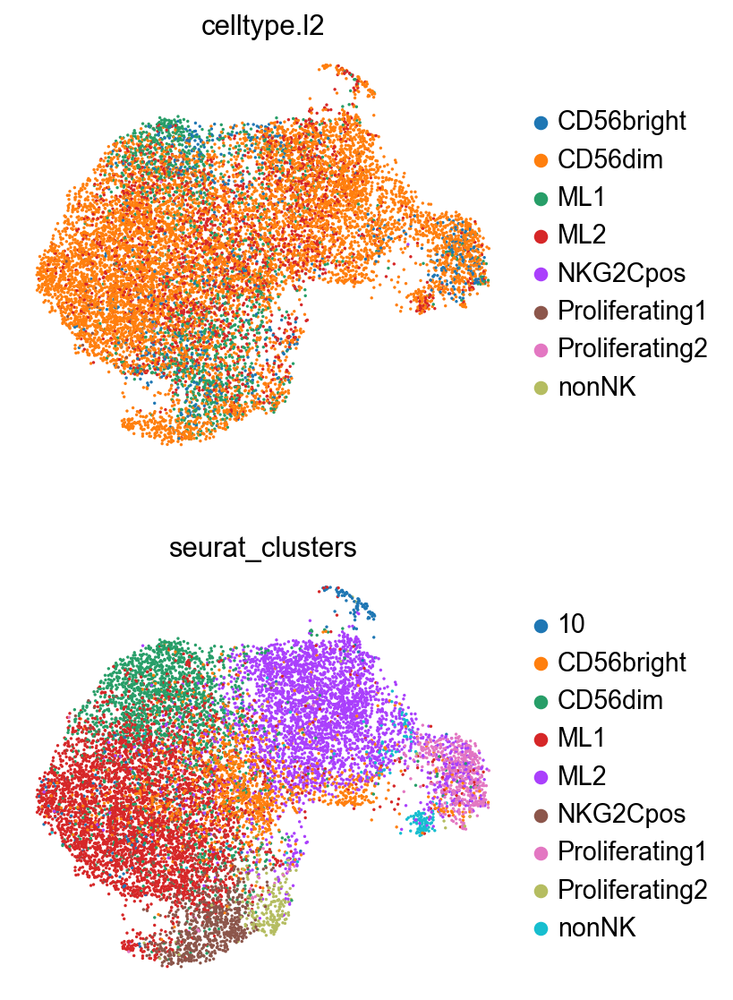

In [117]:
sc.pl.umap(
    query,
    color=["celltype.l2", "seurat_clusters"],
    frameon=False,
    ncols=1,
)

In [118]:
query.obsm["X_umap_project"] = vae.umap_op_.transform(
    query.obsm["X_totalvi_scarches"]
)

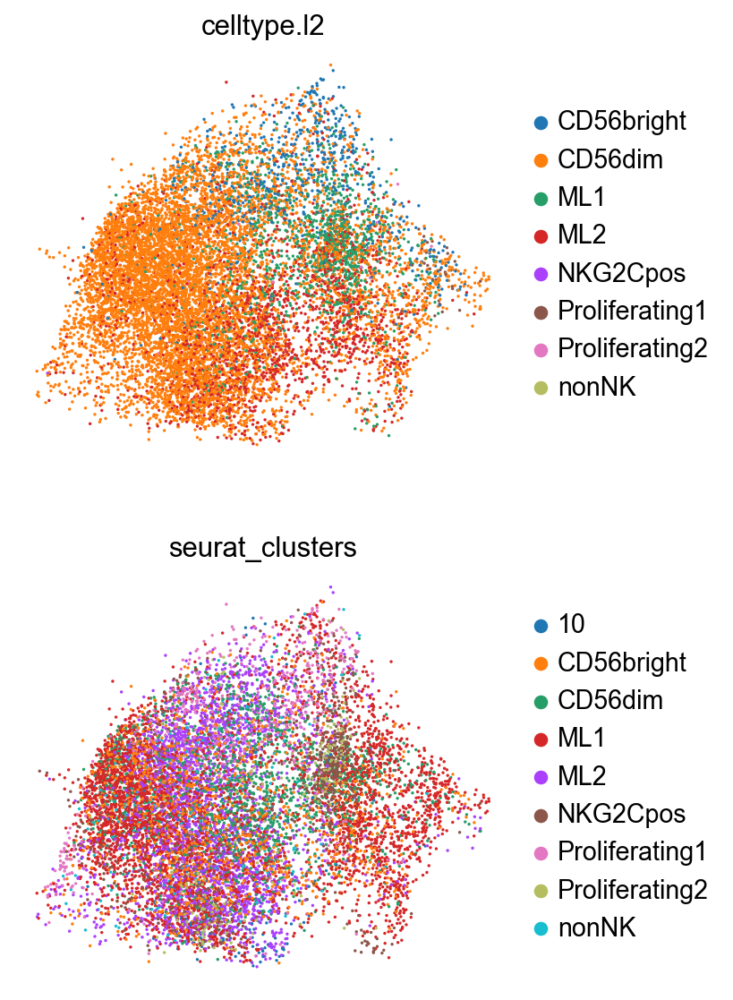

In [119]:
sc.pl.embedding(
    query,
    "X_umap_project",
    color=["celltype.l2", "seurat_clusters"],
    frameon=False,
    ncols=1,
)

In [120]:
umap_adata = sc.AnnData(
    np.concatenate(
        [
            query.obsm["X_umap_project"],
            adata.obsm["X_umap"],
        ],
        axis=0,
    )
)
umap_adata.obs["celltype"] = np.concatenate(
    [query.obs["celltype.l2"].values, adata.obs["celltype.l2"].values]
)
umap_adata.obs["dataset"] = np.concatenate(
    [query.shape[0] * ["query"], adata.shape[0] * ["reference"]]
)
umap_adata.obsm["X_umap"] = umap_adata.X

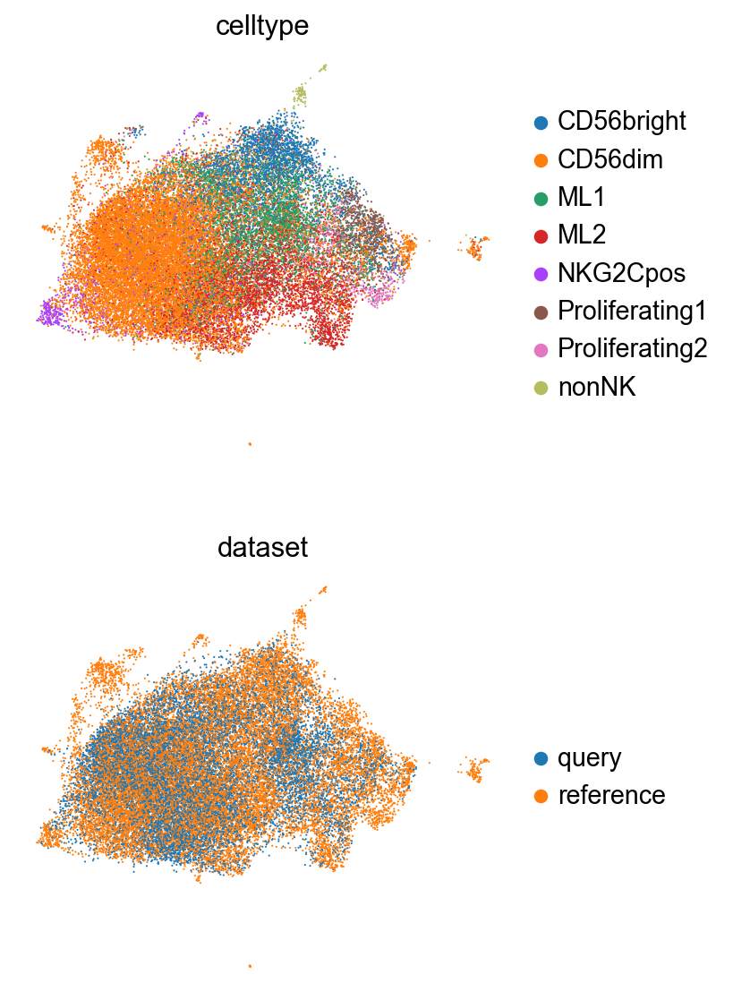

In [121]:
inds = np.random.permutation(np.arange(umap_adata.shape[0]))
sc.pl.umap(
    umap_adata[inds],
    color=["celltype", "dataset"],
    frameon=False,
    ncols=1,
)